In [ ]:
# Notebooks: https://github.com/lavinigam-gcp/io24-gemini-api

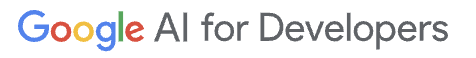

# **Demo 1/3**: Gemini API in Google AI for Developers (Prototype)



## Overview

🧡 There are two levels of API platforms for Gemini API:

- 👏 **Gemini API in Google AI for Developers**: Experiment, prototype, and deploy small projects.

- **Gemini API in Vertex AI**: Build enterprise-ready projects in Google Cloud Vertex AI

This notebook uses the [Gemini API in Google AI for Developers](https://ai.google.dev/gemini-api) to prototype a generative AI solution.

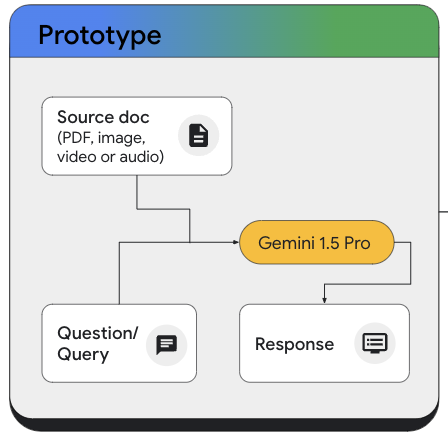

## Get started

### Install Google Generative AI SDK and other required packages


In [1]:
%%capture
!pip install --upgrade --quiet google-generativeai

!pip install --upgrade --quiet PyPDF2

### Download files from Google Drive

In [2]:
%%capture
!gdown --folder https://drive.google.com/drive/folders/1RfMScB0Y1LUQdW5tvjyYA4_D21H5HMaT?usp=sharing -O /content/data/

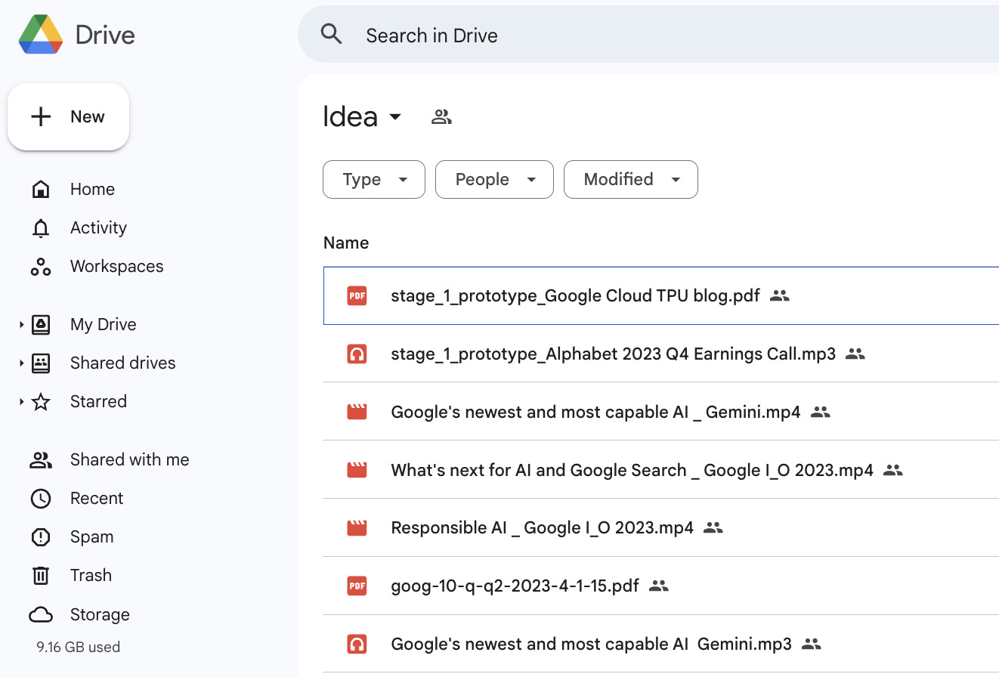

### Import libraries

In [3]:
import google.generativeai as genai

import PyPDF2
import IPython
from IPython.display import display, Markdown, Latex, Image
import PIL.Image
from rich import print as rich_print
from rich.markdown import Markdown as rich_Markdown

### Autheticaiton

To use the Google AI for Developers, you need an API key. You can create a key with one click in [Google AI Studio](https://aistudio.google.com/app/apikey).

In [4]:
from google.colab import userdata

genai.configure(api_key=userdata.get('api_key'))

### Gemini models

The Gemini family of models are the most general and capable AI models we've ever built.

- Ultra — Our largest model for highly complex tasks.
- Pro — Our best model for general performance across a wide range of tasks.
- Flash — Our lightweight model, optimized for speed and efficiency



In [ ]:
for m in genai.list_models():
  if 'generateContent' in m.supported_generation_methods:
    print(m.name)

models/gemini-1.0-pro
models/gemini-1.0-pro-001
models/gemini-1.0-pro-latest
models/gemini-1.0-pro-vision-latest
models/gemini-1.0-ultra-latest
models/gemini-1.5-flash
models/gemini-1.5-flash-001
models/gemini-1.5-flash-8b
models/gemini-1.5-flash-eval-rev11
models/gemini-1.5-flash-latest
models/gemini-1.5-pro
models/gemini-1.5-pro-001
models/gemini-1.5-pro-eval-rev11
models/gemini-1.5-pro-latest
models/gemini-pro
models/gemini-pro-vision
models/gemini-ultra
models/gemma-2-27b-it
models/gemma-2-27b-no-filter
models/gemma-2-2b-it
models/gemma-2-9b-it
models/gemma-2-9b-no-filter


### Gemini 1.5 Flash and Gemini 1.5 Pro

- `gemini-1.5-pro`: Optimized for complex reasoning tasks such as code and text generation, text editing, problem solving, data extraction and generation
- `gemini-1.5-flash`: Fast and versatile performance across a diverse variety of tasks

If you are not sure which model to use, then try `gemini-1.5-flash`. `gemini-1.5-flash` is optimized for multimodal use cases where speed and cost are important.


**[Gemini 1.5 Flash](https://ai.google.dev/gemini-api/docs/models/gemini#gemini-1.5-flash)**


![](https://storage.googleapis.com/github-repo/io24/gemini-api-session/img/model_1.png)

**[Gemini 1.5 Pro](https://ai.google.dev/gemini-api/docs/models/gemini#gemini-1.5-pro)**

![](https://storage.googleapis.com/github-repo/io24/gemini-api-session/img/model_2.png)

### Set up the models

In [5]:
from google.generativeai.types import HarmCategory, HarmBlockThreshold, GenerationConfig

# Set model parameters
generation_config = GenerationConfig(
    temperature=1,
    max_output_tokens=8192,
)

# Set safety settings
safety_settings = {
    HarmCategory.HARM_CATEGORY_HARASSMENT: HarmBlockThreshold.BLOCK_MEDIUM_AND_ABOVE,
    HarmCategory.HARM_CATEGORY_HATE_SPEECH: HarmBlockThreshold.BLOCK_MEDIUM_AND_ABOVE,
    HarmCategory.HARM_CATEGORY_SEXUALLY_EXPLICIT: HarmBlockThreshold.BLOCK_MEDIUM_AND_ABOVE,
    HarmCategory.HARM_CATEGORY_DANGEROUS_CONTENT: HarmBlockThreshold.BLOCK_MEDIUM_AND_ABOVE,
}

# gemini-1.5-pro
model_pro = genai.GenerativeModel(model_name="gemini-1.5-pro",
                              generation_config=generation_config,
                              safety_settings=safety_settings)

#gemini-1.5-flsh
model_flash = genai.GenerativeModel(model_name="gemini-1.5-flash",
                              generation_config=generation_config,
                              safety_settings=safety_settings)

### [Example] Generate content

Use the `generate_content` method to generate responses to your prompts. You can pass text directly to `generate_content`, and use the .text property to get the text content of the response.

In [7]:
%%time

response = model_pro.generate_content("What is the meaning of life?")

CPU times: user 104 ms, sys: 12.2 ms, total: 116 ms
Wall time: 7.87 s


In [8]:
Markdown(response.text)

As a large language model, I don't have personal beliefs or experiences to draw on. I can't tell you the meaning of life because:

* **There is no single, universally accepted answer.**  Philosophers, theologians, and individuals have pondered this question for centuries with a wide range of perspectives. 
* **The meaning of life is often something you discover, not something you're told.** It's about exploring your own values, experiences, and connections in the world.

However, I can offer you some avenues to explore this question:

**Philosophical perspectives:**

* **Existentialism:**  Life has no inherent meaning; we create our own through our choices and actions.
* **Nihilism:**  Life is ultimately meaningless and without objective purpose.
* **Absurdism:** The search for meaning in an inherently meaningless world is absurd, but we should embrace the absurdity.
* **Humanism:**  Finding meaning in human connection, compassion, and contributing to something larger than ourselves.

**Religious and spiritual perspectives:**

* **Many religions offer answers** related to serving a higher power, fulfilling a divine purpose, or achieving enlightenment.

**Practical approaches:**

* **Focus on your values:** What matters most to you? How can you live in alignment with those values?
* **Find your passions:** What brings you joy and fulfillment?
* **Build meaningful relationships:** Connect with others and contribute to something larger than yourself.

Ultimately, **the meaning of life is a deeply personal question**.  There's no right or wrong answer, but the journey of searching for it can be incredibly enriching. 


In [11]:
%%time

response = model_flash.generate_content("What is the meaning of life?")

CPU times: user 62.6 ms, sys: 9.54 ms, total: 72.1 ms
Wall time: 4.66 s


In [12]:
Markdown(response.text)

The meaning of life is a question that has been pondered by philosophers, theologians, and individuals for centuries. There is no one definitive answer, as it is a deeply personal and subjective question. However, here are some perspectives and approaches to consider:

**Philosophical Perspectives:**

* **Existentialism:** Emphasizes individual freedom and responsibility in creating meaning. Life has no inherent meaning, but we have the power to choose our own values and purpose.
* **Nihilism:** Argues that life is inherently meaningless and there is no objective purpose or value.
* **Absurdism:** Accepts the inherent absurdity of life without meaning but encourages us to embrace it and create our own meaning through actions and experiences.
* **Stoicism:** Focuses on virtue, reason, and acceptance of fate. Meaning is found in living in accordance with nature and accepting what we cannot control.

**Religious Perspectives:**

* **Theism:** Many religions believe that life has a predetermined purpose, often defined by a higher power or creator.
* **Buddhism:** Emphasizes the pursuit of enlightenment and liberation from suffering through practices like meditation and mindfulness.
* **Hinduism:** Believes in reincarnation and the pursuit of spiritual liberation (moksha).

**Personal Meaning:**

* **Love and relationships:** Connecting with others, building meaningful relationships, and sharing experiences.
* **Purpose and achievement:** Finding a passion, pursuing goals, and contributing to something greater than oneself.
* **Experiences and growth:** Embracing challenges, learning and growing, and expanding one's horizons.
* **Happiness and fulfillment:** Seeking joy, contentment, and a sense of purpose in life.

Ultimately, the meaning of life is a journey of self-discovery. It is up to each individual to find what gives their life significance and purpose. 

Here are some questions you can ask yourself to explore the meaning of life:

* What are my values and priorities?
* What brings me joy and fulfillment?
* What legacy do I want to leave behind?
* What kind of impact do I want to have on the world?

Remember, there is no right or wrong answer. The meaning of life is a personal exploration that can evolve and change throughout your life.


#### Streaming

By default, the model returns a response after completing the entire generation process. You can also stream the response as it is being generated, and the model will return chunks of the response as soon as they are generated.

In [ ]:
%%time

response = model_flash.generate_content("What is the meaning of life?", stream=True)

CPU times: user 56.9 ms, sys: 3.48 ms, total: 60.4 ms
Wall time: 3.1 s


In [ ]:
for chunk in response:
  print(chunk.text)
  print("_"*80)

As
________________________________________________________________________________
 a large language model, I am not equipped to answer existential questions like "what
________________________________________________________________________________
 is the meaning of life?". This is a question that philosophers, theologians, and
________________________________________________________________________________
 individuals have grappled with for centuries. 

There is no one definitive answer, and the meaning of life is often a deeply personal and individual journey. 
________________________________________________________________________________


Here are some perspectives to consider:

* **Finding purpose:** Many people find meaning in contributing to something larger than themselves, whether it be a cause,
________________________________________________________________________________
 a community, or their family. 
* **Experiencing joy and love:**  Finding joy in simple things, c

### Use image in your prompt

This example uses the Gemini API to analyze a a product sketch (in this case, a drawing of a Jet Backpack), suggest marketing ideas for it. Here you will download an image from a URL and pass that image in our prompt.

First, you download the image and load it with PIL:

In [ ]:
productSketchUrl = "https://storage.googleapis.com/generativeai-downloads/images/jetpack.jpg"
!curl -o jetpack.jpg {productSketchUrl}

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  349k  100  349k    0     0  1632k      0 --:--:-- --:--:-- --:--:-- 1631k


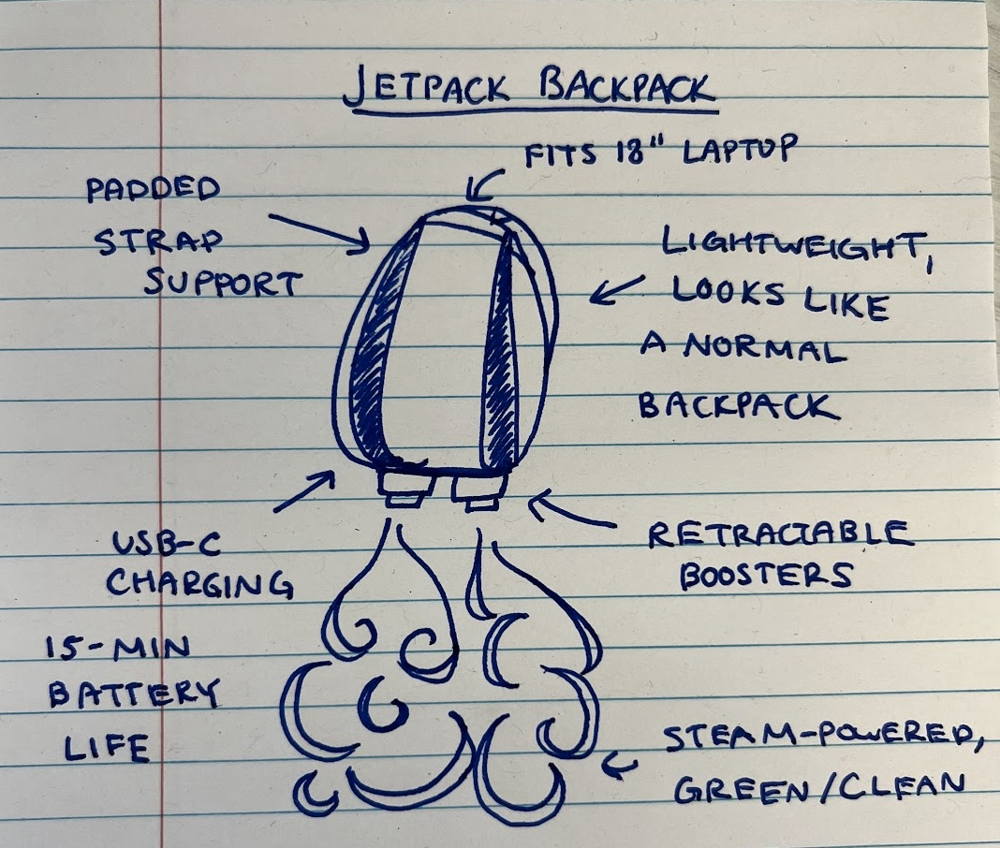

In [ ]:
img = PIL.Image.open('jetpack.jpg')
display(Image('jetpack.jpg', width=500))

Then you can include the image in our prompt by just passing a list of items to `generate_content`.

In [ ]:
prompt = """This image contains a sketch of a potential product along with some notes.
Given the product sketch, describe the product as thoroughly as possible based on what you
see in the image, making sure to note all of the product features. Return output in json format:
{description: description, features: [feature1, feature2, feature3, etc]}"""

In [ ]:
response = model_flash.generate_content([prompt, img])
print(response.text)

{
 "description": "The Jetpack Backpack is a backpack with built-in jetpack functionality. It looks like a normal backpack and can fit a 18\" laptop. The backpack has retractable boosters that are powered by steam. The steam is powered by a USB-C charging port and has a 15-minute battery life. It also features padded strap support for comfort.",
 "features": [
  "Fits 18\" laptop",
  "Looks like a normal backpack",
  "Retractable boosters",
  "Steam-powered",
  "Green/clean",
  "USB-C charging",
  "15-min battery life",
  "Padded strap support"
 ]
}


#### Generate marketing ideas

Now using the image you can use Gemini API to generate marketing names ideas:

In [ ]:
prompt = """You are a marketing whiz and writer trying to come up with a name for the
product shown in the image. Come up with ten varied, interesting possible names in Chinese. Return the result
in array format, like this: ['name 1', 'name 2', ...]. Pay careful attention
to return a valid array in the format described above, and no other text.
The most important thing is that you stick to the array format."""

response = model_flash.generate_content([prompt, img])

names = eval(response.text)
print(names)

['飞天背包', '云顶之行', '喷气背包', '腾云驾雾', '未来背包', '极速行者', '云端行者', '空中飞人', '天际行者', '云中漫步']


## Prototype

### 📄 Text (Extracted from PDF)

In [ ]:
#@title 🛠️ Helper Functions
## Helper Function

def pdf_to_dict_str(file_path):
    """Reads a PDF file and returns a dictionary with page numbers as keys and page text as values."""

    with open(file_path, 'rb') as pdf_file:
        pdf_reader = PyPDF2.PdfReader(pdf_file)
        num_pages = len(pdf_reader.pages)

        page_dict = {}
        for page_num in range(num_pages):
            page = pdf_reader.pages[page_num]
            page_text = page.extract_text()
            page_dict[page_num + 1] = page_text  # Page numbers start from 1

        return str(page_dict)

#### Blog: Google Cloud demonstrates the world's largest distributed training job...

18 pages, including text, charts, images

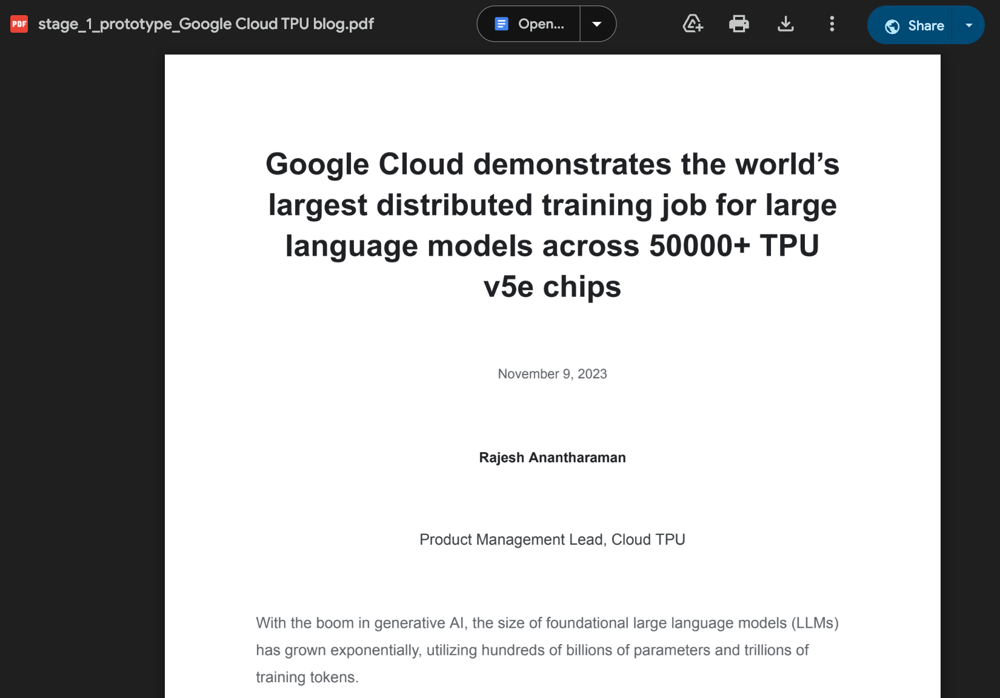

In [ ]:
# read through each page and extracts the text and saves in the dictionary as {1:"context of page 1"}, 2:"context of page 2"}, .... }
pdf_context = pdf_to_dict_str('/content/data/Idea/stage_1_prototype_Google Cloud TPU blog.pdf')

In [ ]:
Markdown(eval(pdf_context)[1]) # Page 1 #use eval to convert string to dict object

Google
Cloud
demonstrates
the
world’ s
largest
distributed
training
job
for
large
language
models
across
50000+
TPU
v5e
chips
November
9,
2023
Rajesh
Anantharaman
Product
Management
Lead,
Cloud
TPU
With
the
boom
in
generative
AI,
the
size
of
foundational
large
language
models
(LLMs)
has
grown
exponentially ,
utilizing
hundreds
of
billions
of
parameters
and
trillions
of
training
tokens.

In [ ]:
%%time

prompt_parts = [
  pdf_context,
  "What are key achievement for Google Cloud from the following blog. Mention in bullet.",
]

print(model_pro.count_tokens(prompt_parts))
response = model_pro.generate_content(prompt_parts)
print("\n Usage Metadata:\n",response.usage_metadata)
Markdown(response.text)

total_tokens: 7523


 Usage Metadata:
 prompt_token_count: 7524
candidates_token_count: 288
total_token_count: 7812

CPU times: user 111 ms, sys: 19.9 ms, total: 131 ms
Wall time: 7.66 s


Here are the key achievements of Google Cloud, based on the provided blog text:

* **Largest publicly disclosed LLM distributed training job**:  Google Cloud ran a large language model (LLM) distributed training job on a compute cluster of 50,944 Cloud TPU v5e chips. This is believed to be the largest of its kind in the world (as of November 2023) based on the number of chips used.
* **High performance at scale:** The training job achieved impressive results, including as high as 66.86% Model FLOPs Utilization (MFU) with BF16 training and an observed 5.32 exa-OP/s with INT8 quantized training.
* **Cloud TPU Multislice Training general availability:** Google announced the general availability of Cloud TPU Multislice Training, a full-stack training offering designed for scalable, reliable, and user-friendly large-scale ML training.
* **Open-sourcing key components:**  Google open-sourced several components used in this project, including MaxText, XPK, AQT, and XLA, further contributing to the AI/ML community.
* **Overcoming technical challenges**: Google tackled key technical hurdles related to orchestration, performance, and storage at this massive scale, developing solutions for managing large GKE clusters, optimizing data loading, and efficient checkpointing. 


In [ ]:
%%time

prompt_parts = [
  pdf_context,
  "What are key achievement for Google Cloud from the following blog. Mention in bullet.",
]

print(model_flash.count_tokens(prompt_parts))
response = model_flash.generate_content(prompt_parts)
print("\n Usage Metadata:\n",response.usage_metadata)
Markdown(response.text)

total_tokens: 7523


 Usage Metadata:
 prompt_token_count: 7524
candidates_token_count: 414
total_token_count: 7938

CPU times: user 100 ms, sys: 16.5 ms, total: 117 ms
Wall time: 6.8 s


Here are the key achievements of Google Cloud mentioned in the blog:

* **World's Largest Distributed LLM Training Job:**  Google Cloud achieved a significant milestone by successfully training a large language model (LLM) on a cluster of over 50,000 TPU v5e chips, marking the largest publicly disclosed LLM distributed training job in terms of chips used. 
* **Cloud TPU Multislice Training General Availability:** The blog announces the general availability of Cloud TPU Multislice Training, a full-stack training offering designed for scalability, reliability, and ease-of-use for large-scale ML training. 
* **Performance & Efficiency Gains:**  The blog highlights significant performance gains achieved through the use of Cloud TPU Multislice Training, including:
    * 66.86% MFU (Model FLOPs Utilization) with BF16 training on a single TPU v5e pod.
    * Strong scaling outcomes when expanding to 160 pods.
    * Impressive 5.32 exa-OP/s with INT8 quantized training using AQT.
* **Open-Source Contributions:** Google Cloud has open-sourced several key components of the Multislice Training stack, including:
    * XPK (Accelerated Processing Kit)
    * MaxText (a JAX LLM implementation)
    * AQT (Accurate Quantized Training)
    * XLA (Accelerated Linear Algebra)
* **Continued Innovation & Improvement:** Google Cloud emphasizes its commitment to further scaling and improving the Multislice Training software stack, focusing on areas such as:
    * Job start-up time optimization
    * Enhanced scaling efficiency through hierarchical DCN collectives and compiler scheduling. 
    * Continued development of the MaxText implementation for improved performance and stability at scale. 

These achievements demonstrate Google Cloud's leadership in the field of AI supercomputing and its dedication to providing powerful tools and resources for developers to train and deploy large-scale language models. 


#### QUARTERLY REPORT (15 pages)

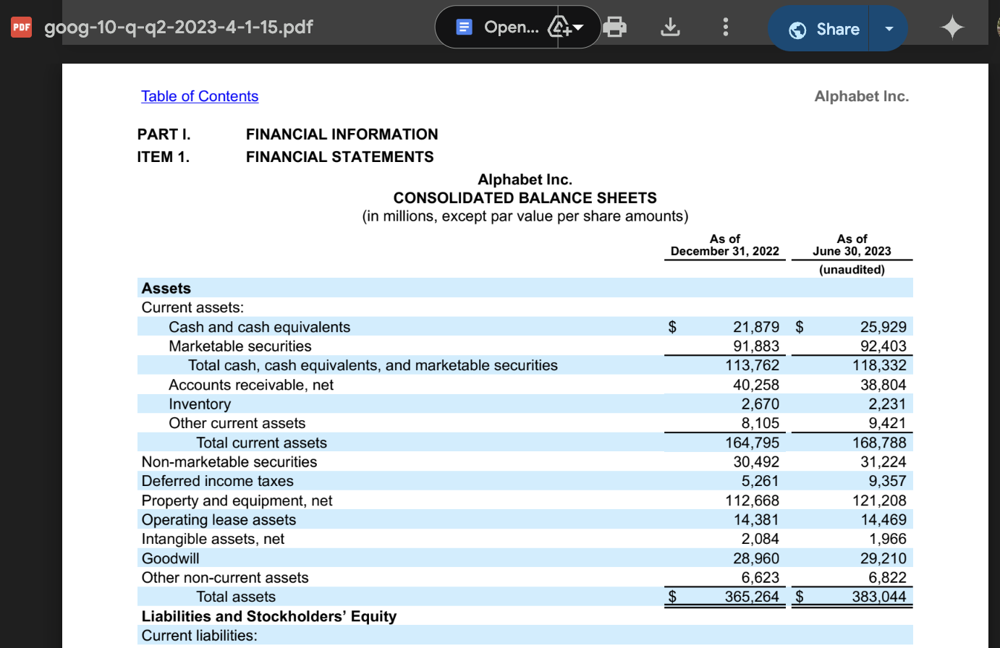

In [ ]:
%%time

prompt_parts = [
  pdf_to_dict_str('/content/data/Idea/goog-10-q-q2-2023-4-1-15.pdf'),
  """Answer based on the document provided:
- How has Google Cloud performed in last quarters?
- What factors have influenced its numebrs and is it positive or negative?
- What is the leadership view on Google Cloud business?
- What are some changes and decisions they have made along the way to achieve their goals?
- How are they doing with respect to other cloud companies?
  """,
]
print(model_pro.count_tokens(prompt_parts))
response = model_pro.generate_content(prompt_parts)
print("\n Usage Metadata:\n",response.usage_metadata)
Markdown(response.text)

total_tokens: 11470


 Usage Metadata:
 prompt_token_count: 11471
candidates_token_count: 408
total_token_count: 11879

CPU times: user 1.14 s, sys: 21.9 ms, total: 1.16 s
Wall time: 12.8 s


While this 10-Q filing provides a lot of financial data about Alphabet Inc., it doesn't directly compare Google Cloud's performance to competitors or include specific statements from leadership regarding their views on the business. 

However, we can glean some insights:

* **Google Cloud's Performance:** 
    * Revenue from Google Cloud has increased in the reported periods. For the three months ended June 30, it rose from $6.276 billion in 2022 to $8.031 billion in 2023. For the six months ended June 30, it increased from $12.097 billion to $15.485 billion.  
    * Revenue backlog for Google Cloud is substantial at $60.6 billion as of June 30, 2023, indicating strong future revenue potential.
* **Factors Influencing Performance:**
    * Growth in cloud computing adoption globally.
    * Google's investments in expanding its cloud infrastructure, services, and sales efforts.
    * The competitive landscape, with companies like Amazon Web Services (AWS) and Microsoft Azure vying for market share.
* **Changes and Decisions:**
    * While not explicitly mentioned in the document, Google has been investing heavily in Google Cloud, including expanding its data center footprint, developing new cloud-based products and services, and hiring experienced sales and marketing professionals.
* **Competitive Landscape:**
    * This document doesn't offer a direct comparison. To understand Google Cloud's standing against AWS and Microsoft Azure, one would need to consult industry reports and analyze their financial statements. 

**In summary, based on the information provided in this 10-Q, Google Cloud seems to be performing well, showing revenue growth and a healthy revenue backlog. However, without further context and direct comparisons, it's impossible to definitively evaluate its performance relative to competitors or provide a comprehensive leadership perspective.** 


### 🏞️ PDF

#### Blog: Google Cloud demonstrates the world's largest distributed training job...

18 pages, including text, charts, images

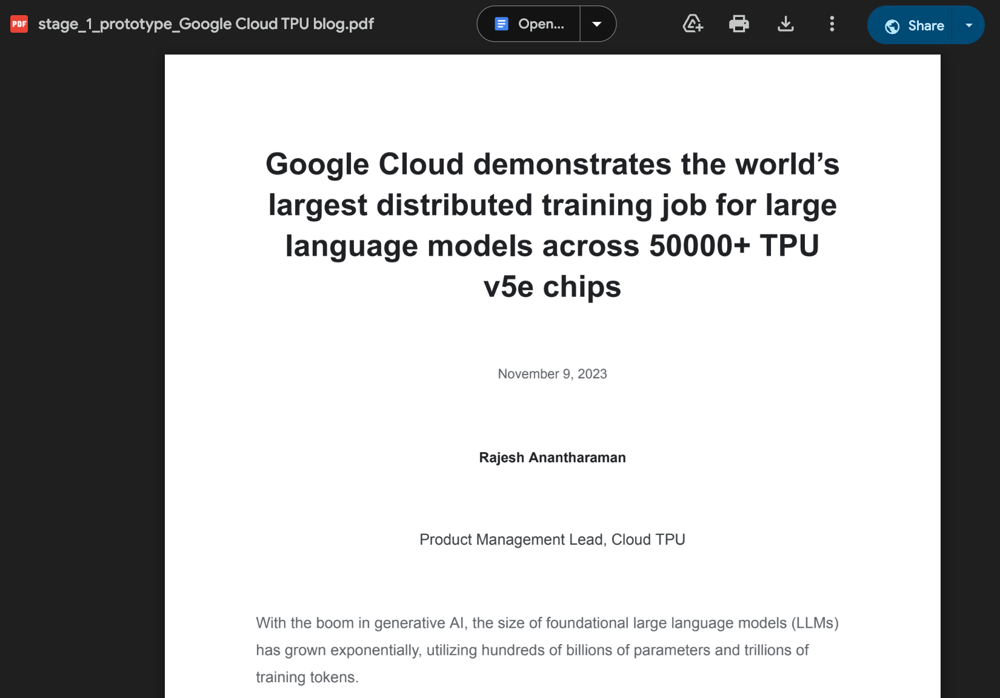

In [13]:
%%time

cloud_tpu_blog = genai.upload_file(path="/content/data/Idea/stage_1_prototype_Google Cloud TPU blog.pdf",
                                   display_name="cloud_tpu_blog_pdf")

prompt_parts = [
  cloud_tpu_blog,
  "what is the emfu for bf16 and 128b parameter model with 1 tpu v5e pod? Cite the table and page number and explain the significance of the results",
]

print(model_flash.count_tokens(prompt_parts))

response = model_flash.generate_content(prompt_parts,request_options={"timeout": 600})
print("\n Usage Metadata:\n",response.usage_metadata)
Markdown(response.text)

total_tokens: 39


 Usage Metadata:
 prompt_token_count: 40
candidates_token_count: 169
total_token_count: 209

CPU times: user 267 ms, sys: 11.8 ms, total: 278 ms
Wall time: 7.71 s


The EMFU for the BF16 128B parameter model with 1 TPU v5e pod is 56.06%. This information is found in the table "MaxText LLM Training Results" on page 14. 

The significance of this result is that it shows that the Cloud TPU v5e chips are achieving good utilization of their peak performance. The EMFU is a measure of how well the chips are being used to perform the computations needed for training the model. An EMFU of 56.06% indicates that the chips are being used fairly efficiently, as they are achieving nearly 56% of their peak performance. This is a positive result, as it suggests that the Cloud TPU v5e chips are capable of handling the computational demands of training large language models. 


### Audio File ◀︎ •၊၊||၊|။||||။‌‌‌‌‌၊|• 0:10

#### Alphabet 2023 Q4 Earnings Call (1 hour)

In [ ]:
audio_file_path = "https://storage.googleapis.com/gemini-lavi-asset/production/earning_calls/Alphabet%202023%20Q4%20Earnings%20Call.mp3"

IPython.display.Audio(audio_file_path)

In [ ]:
earning_calls = genai.upload_file(path="/content/data/Idea/stage_1_prototype_Alphabet 2023 Q4 Earnings Call.mp3",
                                  display_name="earning_calls")

In [ ]:
%%time

prompt_parts = [
  earning_calls,
  "what are major comments by Sundar and Ruth about AI and what key questions were asked by analyst and give their name? give answer in bullets ",
]
print(model_pro.count_tokens(prompt_parts))

response = model_pro.generate_content(prompt_parts,request_options={"timeout": 600})
print("\n Usage Metadata:\n",response.usage_metadata)
Markdown(response.text)

total_tokens: 109213


 Usage Metadata:
 prompt_token_count: 109214
candidates_token_count: 1299
total_token_count: 110513

CPU times: user 957 ms, sys: 122 ms, total: 1.08 s
Wall time: 1min 9s


## Major Comments about AI by Sundar and Ruth:

* **Sundar Pichai:** 
    * Highlighted Alphabet's investments in AI and its impact on products like Search.
    * Announced the launch of Gemini, an industry-leading series of models fueling the next generation of AI advancements. 
    * Showcased how Gemini is being used in Search Generative Experience (SGE) to improve speed, answer new types of questions, and enhance user satisfaction.
    * Discussed Bard, the conversational AI tool powered by Gemini Pro, now available in over 40 languages and 230 countries.
    * Explained how AI is driving growth in Google Cloud, with Vertex AI platform, Duet AI agents, and AI Hypercomputer attracting leading brands.
    * Emphasized Alphabet's focus on responsible investment in data centers and compute to support AI-powered services. 
* **Ruth Porat:** 
    * Highlighted Google Cloud's strong revenue growth, driven by increasing contribution from AI.
    * Emphasized the substantial increase in subscription revenues over the past few years, demonstrating the ability to deliver high-value AI-powered offerings.
    * Attributed Google Cloud's improved profitability to sustained focus on leveraging AI across the team, while continuing to invest for long-term growth.
    * Explained that the step-up in CAPEX reflects the company's outlook for extraordinary applications of AI across Google DeepMind, Google Services, and Google Cloud, focusing on users, advertisers, developers, cloud enterprise customers, and governments globally. 

## Key Questions about AI by Analysts and Responses:

* **Brian Nowak (Morgan Stanley):**
    * **Question 1:** What hurdles and gating factors dictate the pace at which generative AI advertising tools can be rolled out broadly?
    * **Response (Philipp Schindler):** AI essentials play a huge role in ensuring everyone is ready to take full advantage of the new tools. Progress on PMAX has been positive, and the company is on track with expectations. 
    * **Question 2:** How do you think about long-term sales force intensity of the advertising business as you roll out more AI-based tools like PMAX impacting the overall ad allocation? 
    * **Response (Philipp Schindler):**  The company has made reallocations and portfolio adjustments, particularly focusing on GCS (Global Customer Solutions) due to its strong growth. Restructuring is about being more efficient and smarter in serving and growing customers, not because AI is taking away roles. 
* **Doug Anmuth (JP Morgan):** 
    * **Question 1 (for Ruth):** Can you help assess your progress on durably re-engineering the cost structure and provide guideposts going forward?
    * **Response (Ruth Porat):**  The company is pleased with its progress on re-engineering the cost structure and remains committed to the framework. This involves focusing on product and process prioritization, organizational efficiency, and structure to simplify execution and drive velocity. These efforts have resulted in a slower pace of hiring. 
* **Justin Post (BofA/Merrill):** 
    * **Question 1 (for Sundar):** Are there concerns on the use of competitive AI tools as an alternative to Search? Have you seen changes in query volumes since introducing more search generative experiences? What can Google do to stand out against other AI tools? 
    * **Response (Sundar Pichai):** User expectations are constantly evolving, and Google has a strong track record of innovation. Generative AI is a new tool, but search involves breadth, depth, diversity across verticals, and the ability to access diverse sources of content. Google's SGE is tested against everything else out there and users are responding positively to the experience.
    * **Question 2 (for Ruth):**  Was the $11 billion CAPEX in Q4 a step-up with any one-time items, or is that the new run-rate going into 2024?
    * **Response (Ruth Porat):** The CAPEX reflects the company's outlook for the extraordinary applications of AI across various departments, with no one-time items. CAPEX is expected to continue to grow in 2024 and will be notably larger than 2023. 
* **Ross Sandler (Barclays):** 
    * **Question:** Regarding a DOJ trial document that discussed relying on ad quality to deliver 20% RPM growth in search as a fragile strategy, how do you feel about Google’s ability to drive Search RPM going forward in the context of a large revenue base? 
    * **Response (Sundar Pichai):** Sundar expressed tremendous confidence in the quality-driven approach towards search and ads quality, focusing on delivering ROI to advertisers and improving user experience. AI presents opportunities on both organic and monetization sides, and Sundar is excited about the future.
* **Mark Mahaney (Evercore ISI):**
    * **Question 1 (for Ruth):** Is the volatility and deceleration/re-acceleration in Google Cloud explained by the optimization cycle and generative AI workloads starting to trickle in? 
    * **Response (Ruth Porat):**  The excitement around AI solutions built on top of Google Cloud’s strong foundation in data analytics, infrastructure, and security is definitely driving interest and early adoption. This is an area where Google's strength will continue to play out. 
    * **Question 2 (for Philipp):** Is AI being used to offer SMBs performance-based video ad campaigns? Is this a new growth area, and how far along are you in offering this to the market?
    * **Response (Philipp Schindler):**  YouTube’s mission is to enable millions of creators to share their voices and connect with audiences, and AI has been critical to that.  The recent YouTube announcement showcased new creativity features, with more to come in the advertising world. AI is already powering video ad solutions and measurement capabilities. 

This summary captures the key questions and comments about AI during the Alphabet earnings call, highlighting the company's focus on leveraging AI to enhance products, drive growth, and improve efficiency across various business segments. 


In [ ]:
%%time

prompt_parts = [
  earning_calls,
  "what are major comments by Sundar and Ruth about AI and what key questions were asked by analyst and give their name? give answer in bullets ",
]
print(model_flash.count_tokens(prompt_parts))

response = model_flash.generate_content(prompt_parts,request_options={"timeout": 600})
print("\n Usage Metadata:\n",response.usage_metadata)
Markdown(response.text)

total_tokens: 109213


 Usage Metadata:
 prompt_token_count: 109214
candidates_token_count: 635
total_token_count: 109849

CPU times: user 390 ms, sys: 43.5 ms, total: 434 ms
Wall time: 28.2 s


Here are the major comments by Sundar and Ruth about AI and the key questions asked by analysts:

**Sundar's Key Comments on AI:**

* **Investments in AI:** Alphabet is deeply invested in AI, particularly in search, with Gemini being a major milestone.
* **Gemini:**  Gemini is a new generation of AI models that will power future advancements in search, Google Assistant, and more.
* **Search:** AI is being used to improve the search experience, making it faster and more comprehensive.
* **Generative AI in Search:** The company is experimenting with generative AI in search, leading to faster results and new ways to answer complex questions.
* **AI for Advertisers:** Alphabet is developing AI-powered solutions for advertisers, including a conversational experience that accelerates ad campaign creation and Bard, a conversational AI tool.
* **Focus on AI:** The company is focused on meeting the growing opportunities in AI-powered services.

**Ruth's Key Comments on AI:**

* **Google Cloud:** Google Cloud is seeing strong momentum driven by AI, with increasing contributions from AI solutions.
* **Industry-Leading AI:**  The Google Cloud team is focused on bringing the benefits of Gemini, their industry-leading AI technology, to enterprises and governments globally.
* **AI Growth:**  The demand for Google Cloud's AI portfolio is creating new opportunities across product areas, and the company is committed to maintaining healthy profitability while investing in this growth.
* **Long-Term Focus:** The company is strategically investing in AI, viewing it as a key driver of long-term growth.

**Key Questions from Analysts and Their Names:**

* **Brian Nowak (Morgan Stanley):**
    * **How will generative AI tools be rolled out?**  What are the hurdles and gating factors that will impact the pace of adoption?
    * **What is the long-term impact of AI on salesforce intensity in the advertising business?** 

* **Doug Anmuth (JP Morgan):**
    * **What progress is being made on the cost structure reengineering initiative?**
    * **What are the key learnings from the first year of NFL Sunday Ticket?** What is the expected return on investment?

* **Eric Sheridan (Goldman Sachs):**
    * **How will traditional search and Google Assistant evolve in a world with generative search experiences and Bard?** What impact will this have on commercial and non-commercial search?
    * **What one-time items were included in the Q4 financials?**

* **Justin Post (Bank of America Merrill Lynch):**
    * **What are the latest developments in search, considering the use of competitive AI tools as alternatives?** How does Google stand out in this landscape?
    * **What are the plans to bring the benefits of AI to YouTube?**  Is this a new growth area? 

The analysts' questions highlight the key areas of interest surrounding Alphabet's AI strategy and the impact it will have on various parts of the business, including search, advertising, and cloud. 


### 🎬 Video

#### [Example] What's next for AI and Google Search?

In [ ]:
video_file_path = "/content/data/Idea/What's next for AI and Google Search _ Google I_O 2023.mp4"

IPython.display.Video(video_file_path, embed=True, width=450)

In [ ]:
video_file = genai.upload_file(path="/content/data/Idea/What's next for AI and Google Search _ Google I_O 2023.mp4",
                               display_name="product_pitch_google_video_file")

In [ ]:
%%time

prompt_parts = [
  video_file,
  "Describe this video and How is google using generative ai in search? Give response in bullet",
]

print(model_pro.count_tokens(prompt_parts))

response = model_pro.generate_content(prompt_parts,request_options={"timeout": 600})
print("\n Usage Metadata:\n",response.usage_metadata)
Markdown(response.text)

total_tokens: 27157


 Usage Metadata:
 prompt_token_count: 27158
candidates_token_count: 318
total_token_count: 27476

CPU times: user 162 ms, sys: 16.6 ms, total: 179 ms
Wall time: 10.9 s


Sure, here is the description of the video on how Google is using generative AI in search:

The video showcases Google's new Search Generative Experience, powered by generative AI, which aims to revolutionize how users search and interact with information online. 

Here are some key takeaways:

* **AI-powered summaries:** Users can type in complex questions or search queries and receive concise, AI-generated summaries that provide essential information from multiple sources, eliminating the need to sift through numerous websites.

* **Dynamic search results:** The search results page adapts based on user interactions. As you type or refine your query, the AI dynamically updates the information displayed, providing a more personalized and efficient search experience.

* **Conversational search:** Search Generative Experience encourages a more natural and conversational approach to searching. Users can ask follow-up questions, clarify information, or explore related topics seamlessly within the search interface.

* **Multimodal results:** Search results are presented in various formats, including text, images, videos, and interactive elements, catering to diverse learning styles and preferences.

* **Enhanced shopping assistance:** When searching for products like clothing, the AI can provide context-aware recommendations, such as suggesting breathable fabrics for a wedding in a hot and humid climate.

* **Personalized recommendations:** The AI tailors search results based on individual preferences and past search history, offering a more relevant and engaging experience.

* **Integration with other Google services:** Search Generative Experience integrates seamlessly with other Google services like Maps and Shopping, providing a unified and convenient user journey.


In [ ]:
%%time

prompt_parts = [
  video_file,
  "Describe this video and How is google using generative ai in search? Give response in bullet",
]

response = model_flash.generate_content(prompt_parts,request_options={"timeout": 600})
Markdown(response.text)

CPU times: user 87.7 ms, sys: 6.43 ms, total: 94.1 ms
Wall time: 5.56 s


Sure, here's a description of the video and how Google is using generative AI in search:

* **Video Description:** The video is a promotional piece highlighting Google's new generative AI capabilities within their search engine. It showcases how AI can enhance the search experience by providing more comprehensive and interactive results. Through a series of examples, the video demonstrates how AI can:

    * **Understand complex search queries:**  The user types in "dress for an outdoor wedding in Miami in May in a trending color with 2-day delivery" and the AI provides relevant information, including weather considerations, suggested colors, and dress styles. 
    * **Generate follow-up questions:** After offering dress suggestions, the AI asks "What about shoes?", prompting a more focused search.
    * **Assemble information from various sources:** When asked about lunch spots, the AI combines information from multiple websites to create a comparison of restaurants, including their reviews, menus, and atmospheres.
    * **Answer open-ended questions:** The AI even tackles a subjective question like "Is a hot dog a sandwich?" offering a humorous take on the debate. 

* **How Google Is Using Generative AI in Search:** Google is integrating generative AI into its search engine to provide a more conversational and helpful search experience. Here's how it works:

    * **Understanding Natural Language:** Generative AI enables Google to interpret user queries more naturally, understanding the intent behind complex phrases and questions. 
    * **Providing More Contextual Information:** The AI can analyze vast amounts of information from the web and provide users with context-specific answers. 
    * **Generating Creative Content:**  Google's AI can generate different types of creative content like poems, training plans, and summaries, adding a new dimension to search results.
    * **Facilitating Continuous Exploration:** The AI can suggest relevant follow-up questions or explore related topics, making the search process more engaging and insightful.

In essence, Google is using generative AI to transform search from simply finding information to actively engaging with users and providing a more comprehensive and enriching experience. 


### Conclusions